# Modelo de Segmentação G2




## 1. Preparação do Ambiente


### 1.1 Montagem do google drive


In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### 1.2 Importação das Bibliotecas

In [ ]:
import numpy as np
import re
import pandas as pd
import os
import cv2 as cv
import matplotlib.pyplot as plt
from keras.applications import vgg16
from keras.models import Model, load_model
from tensorflow.keras import layers, models
from tensorflow.keras.optimizers import SGD
from tensorflow.keras import regularizers
import pickle
from sklearn.metrics import classification_report
import keras
from keras.layers import Input, Conv2D, Conv2DTranspose, AveragePooling2D, MaxPooling2D, UpSampling2D, LeakyReLU, concatenate, Dropout, BatchNormalization, Activation, SeparableConv2D, DepthwiseConv2D, Add, multiply
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras.optimizers import Adam
from sklearn.model_selection import train_test_split
from numpy.random import seed
import concurrent.futures
seed(222)
import tensorflow as tf
from psutil import virtual_memory
from pickle import dump, load
from keras import backend as K
import time

tf.random.set_seed(222)


## 2. Funções Auxiliares

### 2.1 Processamento da Máscara

In [ ]:
def process_mask(mask):
  hsv_mask = cv.cvtColor(mask, cv.COLOR_BGR2HSV)

  lower_red = np.array([0, 50, 50])
  upper_red = np.array([179, 255, 255])

  red_mask = cv.inRange(hsv_mask, lower_red, upper_red)

  head_mask = mask.copy()
  head_mask[red_mask > 0] = [255, 255, 255]

  eyes_mask = np.zeros_like(mask)
  eyes_mask[red_mask > 0] = [255, 255, 255]

  return head_mask, eyes_mask

### 2.2 Salvamento e Carregamento do modelo de Imagens

In [ ]:
def save_images_model(images_model, filename='images_model.pkl'):
    with open(filename, 'wb') as file:
        pickle.dump(images_model, file)
    print(f"Dados salvos no arquivo {filename}")

In [ ]:
def load_images_model(filename='images_model.pkl'):
    with open(filename, 'rb') as file:
        images_model = pickle.load(file)
    print(f"Dados carregados do arquivo {filename}")
    return images_model

### 2.3 Classe Image para Representação das Imagens

In [ ]:
class Image():
  def __init__(self, x_path, y_path, real, mask):
    self.x_path = x_path
    self.y_path = y_path
    self.real = real
    self.mask = mask
    self.head_mask, self.eye_mask = process_mask(mask)

  def getXPath(self):
    return self.x_path

  def getYPath(self):
    return self.y_path

  def getRealImage(self):
    return self.real

  def getMask(self):
    return self.mask

  def getHeadMask(self):
    return self.head_mask

  def getEyeMask(self):
    return self.eye_mask

### 2.4. Carregamento das Imagens

In [ ]:
import cv2 as cv

def load_images(x_path, y_path):
    # Carregar a imagem real
    real_img = cv.imread(x_path)
    if real_img is None:
        print(f"Imagem não encontrada: {x_path}")
        return None

    # Redimensionar a imagem real
    real_img_resized = cv.resize(real_img, (128, 128))

    # Carregar a máscara
    mask_img = cv.imread(y_path)
    if mask_img is None:
        print(f"Máscara não encontrada: {y_path}")
        return None

    # Redimensionar a máscara
    mask_img_resized = cv.resize(mask_img, (128, 128))

    return Image(x_path, y_path, real_img_resized, mask_img_resized)


### 2.5. Processamento Paralelo das Imagens

In [ ]:
import concurrent.futures

def process_images(x_paths, y_paths):
  count = 0
  images_model = []
  with concurrent.futures.ThreadPoolExecutor() as executor:
    futures = [executor.submit(load_images, x_paths[i], y_paths[i]) for i in range(len(x_paths))]
    for future in concurrent.futures.as_completed(futures):
      result = future.result()
      if result is not None:
        images_model.append(result)
        print(f"Imagem carregada com sucesso: {count}")
        count += 1
      else:
        print(f"Resultado nulo encontrado para o caminho: {x_paths[count]}")
  return images_model


In [ ]:
# paths = []
# with open("/content/drive/MyDrive/CattleImageRepository/paired.txt", "r")as f:
#   for l in f:
#     paths.append(tuple(i.strip() for i in l.split(",")))

In [ ]:
# print(paths)
# def remove_m9(path):
#   return path.replace("M9", "")

# paths = [[remove_m9(path) for path in sublist] for sublist in paths]

In [ ]:
# pattern_x = re.compile(r"_x\d*\.png$")
# pattern_y = re.compile(r"_y\d*\.png$")

In [ ]:
# # Filtrar paths em duas listas, uma para _x e outra para _y
# x_paths = [path for sublist in paths for path in sublist if pattern_x.search(path)]
# y_paths = [path for sublist in paths for path in sublist if pattern_y.search(path)]

In [ ]:
# # Exibir paths filtrados
# print("X Paths:", len(x_paths))
# print("Y Paths:", len(y_paths))

In [ ]:
# # Carregue as imagens de forma paralela
# images_model = process_images(x_paths, y_paths)
# save_images_model(images_model)

### 2.7 Metodo para treinar modelo com device especifico

In [ ]:
# Função para treinar o modelo e medir o tempo
def train_model_on_device(device_name, model, X_train, Y_train, validation_split, callbacks, epochs=41, batch_size=32):
    with tf.device(device_name):
        start_time = time.time()
        history = model.fit(X_train, Y_train, validation_split=validation_split, epochs=epochs, batch_size=batch_size, verbose=1, callbacks=callbacks, shuffle=True)
        end_time = time.time()
        total_time = end_time - start_time
    return total_time, history

## 3. Visualização das Imagens

In [ ]:
images = load_images_model(filename="/content/drive/MyDrive/CattleImageRepository/images_model.pkl")

Dados carregados do arquivo /content/drive/MyDrive/CattleImageRepository/images_model.pkl


In [ ]:
len(images)

3858

/content/drive/MyDrive//CattleImageRepository/G1/01-08-2024/X/01-08-24_video1_00000000205000400_100665_x.png
/content/drive/MyDrive//CattleImageRepository/G1/08-08-2024/Y/01-08-24_video1_00000000205000400_100665_y.png


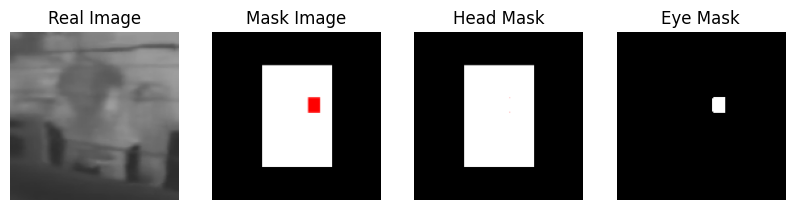

/content/drive/MyDrive//CattleImageRepository/G1/01-08-2024/X/01-08-24_video1_00000000205000400_107520_x.png
/content/drive/MyDrive//CattleImageRepository/G1/01-08-2024/y/01-08-24_video1_00000000205000400_107520_y.png


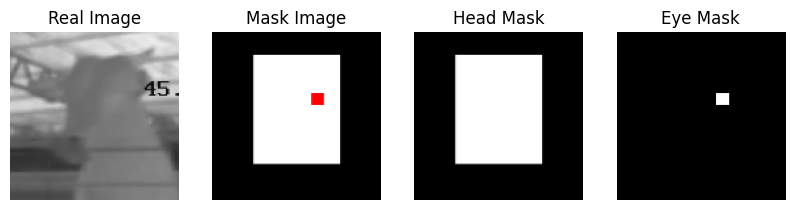

In [ ]:
count = 0
for i in range(len(images)):
  image = images[i]

  x_path = image.getXPath()
  y_path = image.getYPath()
  real = image.getRealImage()
  mask = image.getMask()
  head_mask = image.getHeadMask()
  eye_mask = image.getEyeMask()

  plt.figure(figsize=(10, 5))
  plt.subplot(1, 4, 1)
  plt.imshow(cv.cvtColor(real, cv.COLOR_BGR2RGB), cmap="gray") # Convert from BGR (OpenCV default) to RGB (Matplotlib expects)
  plt.title(f'Real Image')
  plt.axis('off')
  print(x_path)

  plt.subplot(1, 4, 2)
  plt.imshow(cv.cvtColor(mask, cv.COLOR_BGR2RGB), cmap="gray") # Convert from BGR (OpenCV default) to RGB (Matplotlib expects)
  plt.title(f'Mask Image')
  plt.axis('off')
  print(y_path)

  plt.subplot(1, 4, 3)
  plt.imshow(cv.cvtColor(head_mask, cv.COLOR_BGR2RGB), cmap="gray") # Convert from BGR (OpenCV default) to RGB (Matplotlib expects)
  plt.title('Head Mask')
  plt.axis('off')

  plt.subplot(1, 4, 4)
  plt.imshow(cv.cvtColor(eye_mask, cv.COLOR_BGR2RGB), cmap="gray") # Convert from BGR (OpenCV default) to RGB (Matplotlib expects)
  plt.title('Eye Mask')
  plt.axis('off')

  plt.show()
  count += 1
  if count == 2:
    break

## 4. Preparação dos Dados

### 4.1 Extração das Imagens e Máscaras, Normalização dos Dados e Binarização das Máscaras

In [ ]:
# Extrair as imagens e as máscaras de cabeça para o treinamento
X = np.array([image.getRealImage() for image in images])
Y_head = np.array([image.getHeadMask() for image in images])
Y_eye = np.array([image.getEyeMask() for image in images])

# Normalizar os dados para a faixa [0, 1]
X = X / 255.0
Y_head = Y_head / 255.0
Y_eye = Y_eye / 255.0

# Assegurar que as máscaras estão em binário (0 ou 1)
Y_head = (Y_head > 0).astype(np.float32)
Y_eye = (Y_eye > 0).astype(np.float32)

### 4.2 Divisão dos Dados em Treinamento e Teste

In [ ]:
from sklearn.model_selection import train_test_split

# Dividir os dados em treinamento e teste
X_train, X_test, Y_head_train, Y_head_test, Y_eye_train, Y_eye_test = train_test_split(
    X, Y_head, Y_eye, test_size=0.2, random_state=42
)


In [ ]:
# # Se a última dimensão não é 1, reduza para 1 canal
# Y_head_train = np.mean(Y_head_train, axis=-1, keepdims=True) if Y_head_train.shape[-1] == 3 else Y_head_train
# Y_eye_train = np.mean(Y_eye_train, axis=-1, keepdims=True) if Y_eye_train.shape[-1] == 3 else Y_eye_train

# Y_head_test = np.mean(Y_head_test, axis=-1, keepdims=True) if Y_head_test.shape[-1] == 3 else Y_head_test
# Y_eye_test = np.mean(Y_eye_test, axis=-1, keepdims=True) if Y_eye_test.shape[-1] == 3 else Y_eye_test

# print(X_train.shape)
# print(Y_head_train.shape)  # Verifique o novo formato
# print(Y_eye_train.shape)  # Verifique o novo formato


## 5. Criação do Modelo **Com Técnicas contra overfitting**

Estamos usando as seguintes técnicas para buscar evitar o overfitting do modelo:

*   Congelamento de Camadas do VGG16
*   Dropout
*   Batchnormalization
*   Early Stopping
*   Regularização L2

Tais técnicas serão explicadas no trecho de código onde estão sendo utilizadas.



#### 5.1 Carregamento do VGG16

In [ ]:
path_to_VGG16 = "/content/drive/MyDrive/M9/2024-2A-T05/Encontros/2024-09-04 | Semana 5 | Programação | (Visão Aula 6) Transfer Learning (sobre o ombro de gigantes)/Parte 2/VGG16/vgg16_weights_tf_dim_ordering_tf_kernels.weights.h5"

In [ ]:
input_shape = (128, 128, 3)
VGG16 = vgg16.VGG16(include_top=False, weights='imagenet', input_shape=input_shape)

In [ ]:
VGG16.input

<KerasTensor shape=(None, 128, 128, 3), dtype=float32, sparse=None, name=keras_tensor>

In [ ]:
output_ = VGG16.output
output_

<KerasTensor shape=(None, 4, 4, 512), dtype=float32, sparse=False, name=keras_tensor_18>

Congelamento de Camadas do VGG16:
o congelamento de camadas do VGG16 ajuda a evitar o overfitting porque mantém os pesos das camadas pré-treinadas fixos, impedindo que sejam ajustados durante o treinamento modelo. Nesse caso, nós congelamos 4 camadas  evitando que o modelo se ajuste excessivamente a esses dados, o que causaria overfitting e reduziria a capacidade de generalização.
As últimas camadas, que continuam treináveis e podem se especializar para a sua tarefa, enquanto as camadas congeladas garantem uma base sólida.

In [ ]:
set_trainable = False
for layer in VGG16.layers[:-4]:
        layer.trainable = False

In [ ]:
vgg_model = Model(VGG16.input, output_)
layers = [(layer.name, layer.trainable) for layer in vgg_model.layers]
pd.DataFrame(layers, columns=['Layer Name', 'Layer Trainable'])

,Layer Name,Layer Trainable
0,input_layer,False
1,block1_conv1,False
2,block1_conv2,False
3,block1_pool,False
4,block2_conv1,False
5,block2_conv2,False
6,block2_pool,False
7,block3_conv1,False
8,block3_conv2,False
9,block3_conv3,False


In [ ]:
vgg_model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 128, 128, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 128, 128, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 128, 128, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 64, 64, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 64, 64, 128)         │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 32, 32, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 32, 32, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 32, 32, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 16, 16, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 16, 16, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 16, 16, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 16, 16, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 8, 8, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 8, 8, 512)           │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 8, 8, 512)           │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 8, 8, 512)           │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 4, 4, 512)           │               0 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 7,079,424 (27.01 MB)

 Non-trainable params: 7,635,264 (29.13 MB)

In [ ]:
vgg_model.output

<KerasTensor shape=(None, 4, 4, 512), dtype=float32, sparse=False, name=keras_tensor_18>

In [ ]:
K.clear_session()

#### 5.2 Configuração da Treinamento da U-Net



*   Regularização L2: penaliza pesos grandes no modelo, isso força o modelo a manter os pesos pequenos, o que torna o modelo mais simples e menos provável a overfitar. Portanto o modelo se torna mais capaz de generalizar para novos dados.
*   Dropout: força o modelo a não depender de neurônios específicos, pois desativa aleatoriamente alguns neurônios, impedindo que o modelo se ajuste excessivamente a padrões específicos nos dados de treinamento.
*   Batch normalization: normaliza a saída de cada camada reduzindo a covariância interna dos dados, o que ajuda a acelerar o treinamento e a estabilizar o aprendizado.





In [ ]:
def conv_block(input_tensor, num_filters):
    # Bloco de convolução com regularização, normalização em lote e ativação LeakyReLU

    # Primeira camada de convolução com regularização L2 (penalização de pesos)
    x = Conv2D(num_filters, 3, padding="same", kernel_regularizer=regularizers.l2(1e-4))(input_tensor)
    x = BatchNormalization()(x) # Normalização para estabilizar o treinamento
    x = tf.keras.layers.LeakyReLU(alpha=0.1)(x)
    x = Dropout(0.3)(x)  # Dropout com taxa de 30% para prevenir overfitting

    # Segunda camada de convolução com regularização L2
    x = Conv2D(num_filters, 3, padding="same", kernel_regularizer=regularizers.l2(1e-4))(x)
    x = BatchNormalization()(x)
    x = tf.keras.layers.LeakyReLU(alpha=0.1)(x)

    return x


def decoder_block(input_tensor, concat_tensor, num_filters):
    # Bloco de decodificação que aumenta a resolução da imagem (upscaling) usando convolução transposta
    # Também aplica uma conexão de salto (skip connection) entre o encoder e o decoder
    x = Conv2DTranspose(num_filters, (2, 2), strides=(2, 2), padding="same")(input_tensor) # Convolução transposta para aumentar a resolução
    x = concatenate([x, concat_tensor]) # Concatena a saída do decoder com a saída do encoder correspondente
    x = conv_block(x, num_filters)
    return x

In [ ]:
def unet_model(input_size=(128, 128, 3)):


    # Obtém as saídas intermediárias das camadas do VGG16 para as skip connections
    s1 = VGG16.get_layer("block1_conv2").output
    s2 = VGG16.get_layer("block2_conv2").output
    s3 = VGG16.get_layer("block3_conv3").output
    s4 = VGG16.get_layer("block4_conv3").output

    # Bottle neck (camada mais profunda entre o encoder e o decoder)
    b1 = VGG16.get_layer("block5_conv3").output

    # Decoder: reconstrói a imagem de volta para a resolução original
    d1 = decoder_block(b1, s4, 512)
    d2 = decoder_block(d1, s3, 256)
    d3 = decoder_block(d2, s2, 128)
    d4 = decoder_block(d3, s1, 64)


    # Camada de saída, aplica convolução 1x1 para gerar a saída com três canais (imagem segmentada)
    outputs = Conv2D(3, (1, 1), activation='sigmoid')(d4)  # Ativação sigmoide para normalizar a saída entre 0 e 1

    model = Model(inputs=VGG16.input, outputs=outputs)
    return model


### 5.3 Construção da U-Net Customizada

In [ ]:
# Criar o modelo U-Net
model = unet_model()

/usr/local/lib/python3.10/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


### 5.4 Funções de Perda

In [ ]:
def dice_loss(y_true, y_pred):
    # Função de perda Dice, usada para comparar a similaridade entre duas imagens
    smooth = 1.0  # Evita divisão por zero

    # Torna tensores em um vetor para facilitar o cálculo da interseção
    flatten = tf.keras.layers.Flatten()
    y_true_f = flatten(y_true)
    y_pred_f = flatten(y_pred)
    # Calcula a interseção entre as previsões e os valores reais
    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    return 1 - (2. * intersection + smooth) / (tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) + smooth)

In [ ]:
def combined_loss(y_true, y_pred):
    # Função de perda combinada que utiliza a entropia cruzada binária (Binary Crossentropy) e a loss Dice
    bce_loss = tf.keras.losses.binary_crossentropy(y_true, y_pred)
    dice = dice_loss(y_true, y_pred)
    return bce_loss + dice # Retorna a soma das duas perdas como a função de perda total

In [ ]:
# Métrica Dice Coefficient
def dice_coeff(y_true, y_pred):
    return 1 - dice_loss(y_true, y_pred)

### 5.5 Compilação do Modelo

In [ ]:
model.compile(
    optimizer=Adam(learning_rate=1e-4), # Otimizador Adam com uma taxa de aprendizado de 0.0001
    loss=combined_loss,
    metrics=[dice_coeff,'accuracy'],
)

In [ ]:
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 128, 128, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1_conv1 (Conv2D)     │ (None, 128, 128, 64)   │          1,792 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1_conv2 (Conv2D)     │ (None, 128, 128, 64)   │         36,928 │ block1_conv1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1_pool               │ (None, 64, 64, 64)     │              0 │ block1_conv2[0][0]     │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block2_conv1 (Conv2D)     │ (None, 64, 64, 128)    │         73,856 │ block1_pool[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block2_conv2 (Conv2D)     │ (None, 64, 64, 128)    │        147,584 │ block2_conv1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block2_pool               │ (None, 32, 32, 128)    │              0 │ block2_conv2[0][0]     │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block3_conv1 (Conv2D)     │ (None, 32, 32, 256)    │        295,168 │ block2_pool[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block3_conv2 (Conv2D)     │ (None, 32, 32, 256)    │        590,080 │ block3_conv1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block3_conv3 (Conv2D)     │ (None, 32, 32, 256)    │        590,080 │ block3_conv2[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block3_pool               │ (None, 16, 16, 256)    │              0 │ block3_conv3[0][0]     │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block4_conv1 (Conv2D)     │ (None, 16, 16, 512)    │      1,180,160 │ block3_pool[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block4_conv2 (Conv2D)     │ (None, 16, 16, 512)    │      2,359,808 │ block4_conv1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block4_conv3 (Conv2D)     │ (None, 16, 16, 512)    │      2,359,808 │ block4_conv2[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block4_pool               │ (None, 8, 8, 512)      │              0 │ block4_conv3[0][0]     │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block5_conv1 (Conv2D)     │ (None, 8, 8, 512)      │      2,359,808 │ block4_pool[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block5_conv2 (Conv2D)     │ (None, 8, 8, 512)      │      2,359,808 │ block5_conv1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block5_conv3 (Conv2D)

 Total params: 25,862,467 (98.66 MB)

 Trainable params: 18,223,363 (69.52 MB)

 Non-trainable params: 7,639,104 (29.14 MB)

## 5. Criação do Modelo **sem técnicas contra overfitting**

Nesse modelo não aplicaremos técnicas contra o overfitting como: Dropout, Early Stopping, Batchnormalization, Regularização L2.

#### 5.1 Carregamento do VGG16

In [ ]:
path_to_VGG16 = "/content/drive/MyDrive/M9/2024-2A-T05/Encontros/2024-09-04 | Semana 5 | Programação | (Visão Aula 6) Transfer Learning (sobre o ombro de gigantes)/Parte 2/VGG16/vgg16_weights_tf_dim_ordering_tf_kernels.weights.h5"

In [ ]:
input_shape = (128, 128, 3)
VGG16 = vgg16.VGG16(include_top=False, weights='imagenet', input_shape=input_shape)

In [ ]:
VGG16.input

<KerasTensor shape=(None, 128, 128, 3), dtype=float32, sparse=None, name=keras_tensor_37>

In [ ]:
output_ = VGG16.output
output_

<KerasTensor shape=(None, 4, 4, 512), dtype=float32, sparse=False, name=keras_tensor_55>

In [ ]:
set_trainable = False
for layer in VGG16.layers:
        layer.trainable = True

In [ ]:
vgg_model = Model(VGG16.input, output_)
layers = [(layer.name, layer.trainable) for layer in vgg_model.layers]
pd.DataFrame(layers, columns=['Layer Name', 'Layer Trainable'])

,Layer Name,Layer Trainable
0,input_layer,True
1,block1_conv1,True
2,block1_conv2,True
3,block1_pool,True
4,block2_conv1,True
5,block2_conv2,True
6,block2_pool,True
7,block3_conv1,True
8,block3_conv2,True
9,block3_conv3,True


In [ ]:
vgg_model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)             │ (None, 128, 128, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 128, 128, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 128, 128, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 64, 64, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 64, 64, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 64, 64, 128)         │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 32, 32, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 32, 32, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 32, 32, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 32, 32, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 16, 16, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 16, 16, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 16, 16, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 16, 16, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 8, 8, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 8, 8, 512)           │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 8, 8, 512)           │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 8, 8, 512)           │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 4, 4, 512)           │               0 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 14,714,688 (56.13 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
vgg_model.output

<KerasTensor shape=(None, 4, 4, 512), dtype=float32, sparse=False, name=keras_tensor_55>

In [ ]:
K.clear_session()

#### 5.2 Configuração da Treinamento da U-Net

In [ ]:
def conv_block_overfit(input_tensor, num_filters):
    x = Conv2D(num_filters, 3, padding="same")(input_tensor)
    x = tf.keras.layers.LeakyReLU(alpha=0.1)(x)
    x = Conv2D(num_filters, 3, padding="same")(x)
    x = tf.keras.layers.LeakyReLU(alpha=0.1)(x)

    return x


def decoder_block_overfit(input_tensor, concat_tensor, num_filters):
    x = Conv2DTranspose(num_filters, (2, 2), strides=(2, 2), padding="same")(input_tensor)
    x = concatenate([x, concat_tensor])
    x = conv_block_overfit(x, num_filters)
    return x

In [ ]:
def unet_model_overfit(input_size=(128, 128, 3)):


    # Get intermediate layers for skip connections
    s1 = VGG16.get_layer("block1_conv2").output
    s2 = VGG16.get_layer("block2_conv2").output
    s3 = VGG16.get_layer("block3_conv3").output
    s4 = VGG16.get_layer("block4_conv3").output

    # Bridge
    b1 = VGG16.get_layer("block5_conv3").output

    # Decoder
    d1 = decoder_block_overfit(b1, s4, 512)
    d2 = decoder_block_overfit(d1, s3, 256)
    d3 = decoder_block_overfit(d2, s2, 128)
    d4 = decoder_block_overfit(d3, s1, 64)


    outputs = Conv2D(3, (1, 1), activation='sigmoid') (d4)


    model = Model(inputs=VGG16.input, outputs=outputs)
    return model


### 5.3 Construção da U-Net Customizada

In [ ]:
# Criar o modelo U-Net
model_overfit = unet_model_overfit()

/usr/local/lib/python3.10/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


### 5.4 Funções de Perda

In [ ]:
def dice_loss(y_true, y_pred):
    smooth = 1.0  # Evita divisão por zero

    # Flatten the tensors using tf.keras.layers.Flatten()
    flatten = tf.keras.layers.Flatten()
    y_true_f = flatten(y_true)
    y_pred_f = flatten(y_pred)

    intersection = tf.reduce_sum(y_true_f * y_pred_f)
    return 1 - (2. * intersection + smooth) / (tf.reduce_sum(y_true_f) + tf.reduce_sum(y_pred_f) + smooth)

In [ ]:
def combined_loss(y_true, y_pred):
    bce_loss = tf.keras.losses.binary_crossentropy(y_true, y_pred)
    dice = dice_loss(y_true, y_pred)
    return bce_loss + dice

In [ ]:
# Métrica Dice Coefficient
def dice_coeff(y_true, y_pred):
    return 1 - dice_loss(y_true, y_pred)

### 5.5 Compilação do Modelo

In [ ]:
model_overfit.compile(
    optimizer=Adam(learning_rate=1e-4),
    loss=combined_loss,
    metrics=[dice_coeff,'accuracy'],
)

In [ ]:
model_overfit.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 128, 128, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1_conv1 (Conv2D)     │ (None, 128, 128, 64)   │          1,792 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1_conv2 (Conv2D)     │ (None, 128, 128, 64)   │         36,928 │ block1_conv1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1_pool               │ (None, 64, 64, 64)     │              0 │ block1_conv2[0][0]     │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block2_conv1 (Conv2D)     │ (None, 64, 64, 128)    │         73,856 │ block1_pool[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block2_conv2 (Conv2D)     │ (None, 64, 64, 128)    │        147,584 │ block2_conv1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block2_pool               │ (None, 32, 32, 128)    │              0 │ block2_conv2[0][0]     │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block3_conv1 (Conv2D)     │ (None, 32, 32, 256)    │        295,168 │ block2_pool[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block3_conv2 (Conv2D)     │ (None, 32, 32, 256)    │        590,080 │ block3_conv1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block3_conv3 (Conv2D)     │ (None, 32, 32, 256)    │        590,080 │ block3_conv2[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block3_pool               │ (None, 16, 16, 256)    │              0 │ block3_conv3[0][0]     │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block4_conv1 (Conv2D)     │ (None, 16, 16, 512)    │      1,180,160 │ block3_pool[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block4_conv2 (Conv2D)     │ (None, 16, 16, 512)    │      2,359,808 │ block4_conv1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block4_conv3 (Conv2D)     │ (None, 16, 16, 512)    │      2,359,808 │ block4_conv2[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block4_pool               │ (None, 8, 8, 512)      │              0 │ block4_conv3[0][0]     │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block5_conv1 (Conv2D)     │ (None, 8, 8, 512)      │      2,359,808 │ block4_pool[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block5_conv2 (Conv2D)     │ (None, 8, 8, 512)      │      2,359,808 │ block5_conv1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block5_conv3 (Conv2D)

 Total params: 25,854,787 (98.63 MB)

 Trainable params: 25,854,787 (98.63 MB)

 Non-trainable params: 0 (0.00 B)

## 6. Treinamento e Salvamento do Modelo

### 6.1 Treinamento do Modelo **Com Técnicas contra overfitting**

In [ ]:
checkpointer = ModelCheckpoint(
    filepath='/content/drive/MyDrive/CattleImageRepository/segmentacao.keras',
    verbose=1,
    save_best_only=True,
    mode="auto",
    monitor="loss"
)

*   Early Stopping: para o treinamento assim que o modelo começa a se degradar na métrica que estamos monitorando, que é acurária pois isso indica um possível overfitting, o Early Stopping evita que o modelo se ajuste excessivamente aos dados de treinamento e perca a capacidade de generalização para novos dados.

In [ ]:
early_stopping = EarlyStopping(monitor='accuracy',
                               patience=7,
                               restore_best_weights=True)

In [ ]:
gpu_time_second, gpu_history_second = train_model_on_device("/GPU:0", model, X_train, Y_head_train, 0.1, [checkpointer, early_stopping], epochs = 45, batch_size = 16)

/usr/local/lib/python3.10/dist-packages/tensorflow/python/data/ops/structured_function.py:258: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


Epoch 1/45
174/174 ━━━━━━━━━━━━━━━━━━━━ 0s 464ms/step - accuracy: 0.3478 - dice_coeff: 0.6184 - loss: 1.0725
Epoch 1: loss improved from inf to 0.86193, saving model to /content/drive/MyDrive/CattleImageRepository/segmentacao.keras
174/174 ━━━━━━━━━━━━━━━━━━━━ 87s 492ms/step - accuracy: 0.3477 - dice_coeff: 0.6189 - loss: 1.0713 - val_accuracy: 0.4558 - val_dice_coeff: 0.7884 - val_loss: 0.8525
Epoch 2/45
174/174 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step - accuracy: 0.3411 - dice_coeff: 0.7859 - loss: 0.6624
Epoch 2: loss improved from 0.86193 to 0.62782, saving model to /content/drive/MyDrive/CattleImageRepository/segmentacao.keras
174/174 ━━━━━━━━━━━━━━━━━━━━ 87s 497ms/step - accuracy: 0.3411 - dice_coeff: 0.7859 - loss: 0.6622 - val_accuracy: 0.2456 - val_dice_coeff: 0.8045 - val_loss: 0.6494
Epoch 3/45
174/174 ━━━━━━━━━━━━━━━━━━━━ 0s 470ms/step - accuracy: 0.3149 - dice_coeff: 0.8184 - loss: 0.5715
Epoch 3: loss improved from 0.62782 to 0.54428, saving model to /content/drive/MyDrive/Catt

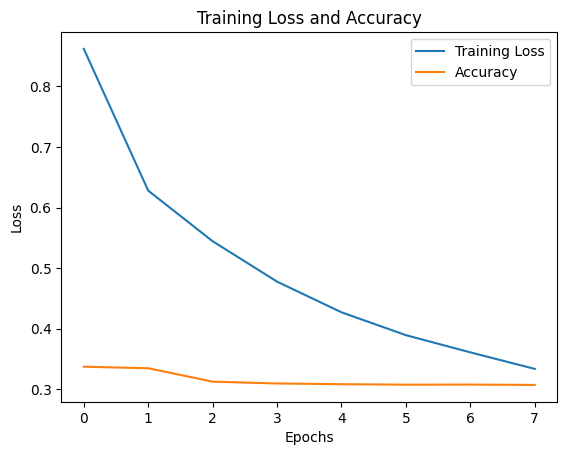

In [ ]:
# Dados
training_loss = history.history['loss']
accuracy = history.history['accuracy']

# Plot
plt.plot(training_loss, label='Training Loss')
plt.plot(accuracy, label='Accuracy')
plt.title('Training Loss and Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
index = np.argmax(history.history['accuracy'])
index

0

In [ ]:
TransferLearningModel = load_model('/content/drive/MyDrive/CattleImageRepository/G2/segmentacao.keras', custom_objects={'dice_loss': dice_loss, })

In [ ]:
prediction = model.predict(X_test)

25/25 ━━━━━━━━━━━━━━━━━━━━ 4s 159ms/step




*   **Resultados para os dados de teste**




O modelo demonstrou uma boa performance nos dados de teste, indicando que as técnicas de regularização aplicadas foram eficazes na prevenção do overfitting. Embora a acurácia nos dados de treinamento não tenha sido tão elevada, o modelo conseguiu segmentar corretamente a cabeça dos bovinos nos dados de teste. Isso comprova a eficácia das técnicas implementadas e a capacidade do modelo de generalizar bem para novos dados.

In [ ]:

prediction_binary = (prediction > 0.5).astype(int)


y_true_flat = Y_head_test.flatten()
y_pred_flat = prediction_binary.flatten()

teste = classification_report(y_true_flat, y_pred_flat)
print(teste)

              precision    recall  f1-score   support

         0.0       0.93      0.82      0.87  23249258
         1.0       0.76      0.91      0.82  14696086

    accuracy                           0.85  37945344
   macro avg       0.84      0.86      0.85  37945344
weighted avg       0.86      0.85      0.85  37945344



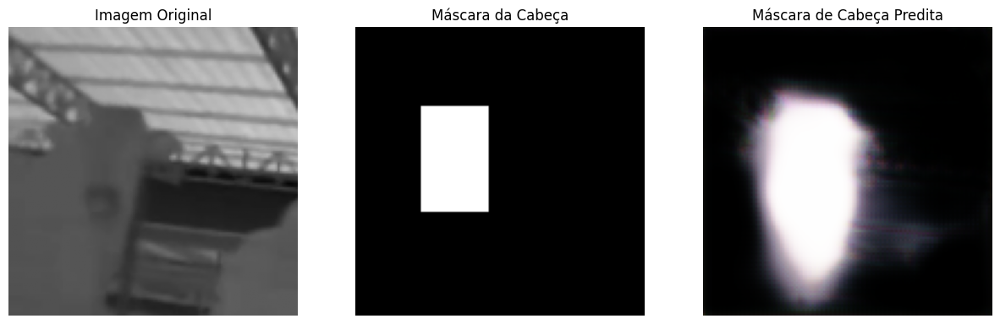

In [ ]:
# Configuração do layout para 1 linha e 3 colunas
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Imagem original
axs[0].imshow(X_test[55])
axs[0].set_title("Imagem Original")
axs[0].axis('off')

# Máscara da cabeça real
axs[1].imshow(Y_head_test[55])
axs[1].set_title("Máscara da Cabeça")
axs[1].axis('off')

# Máscara de cabeça predita
reshaped_tensor = prediction[55]
axs[2].imshow(reshaped_tensor)
axs[2].set_title("Máscara de Cabeça Predita")
axs[2].axis('off')

# Exibindo as imagens
plt.show()

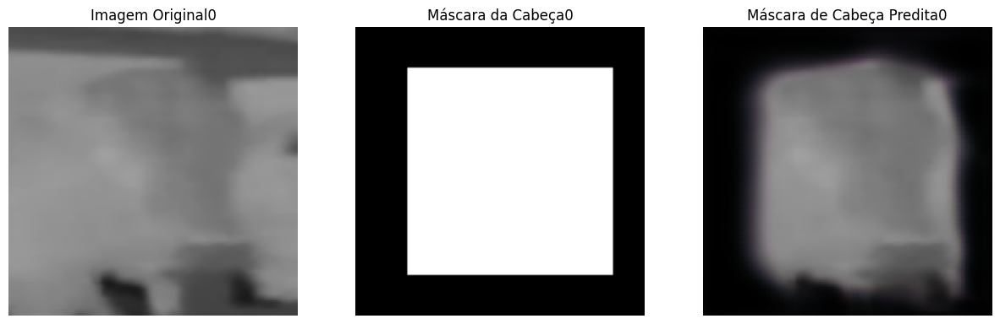

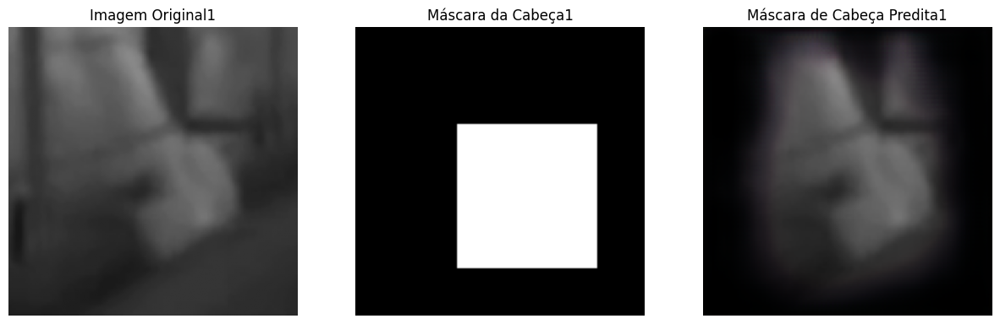

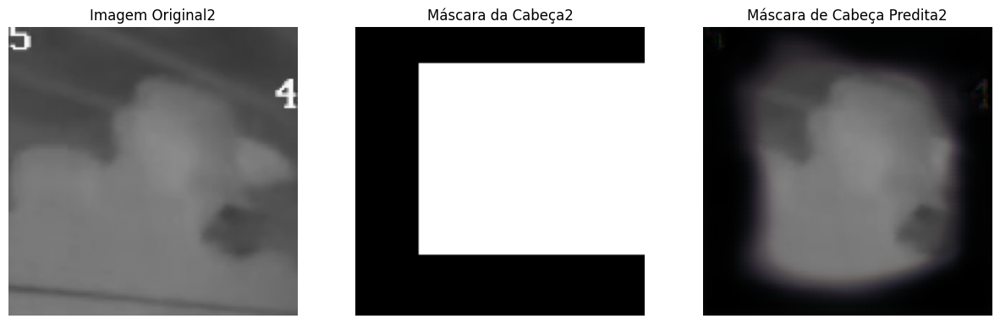

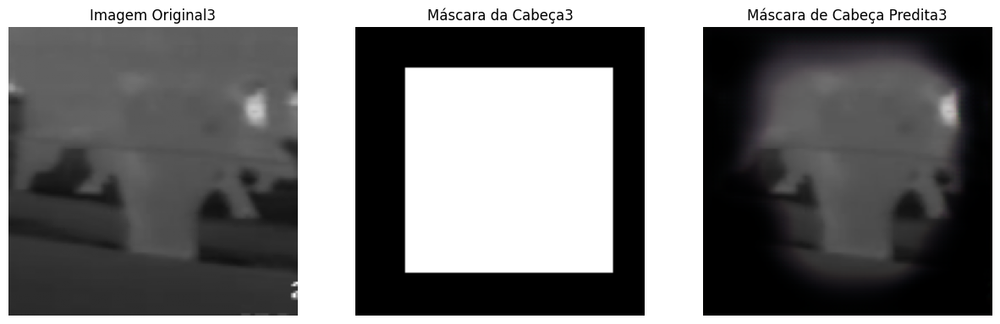

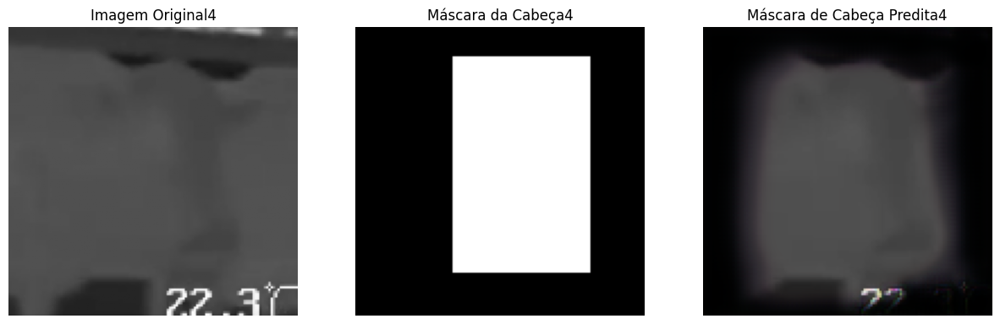

...

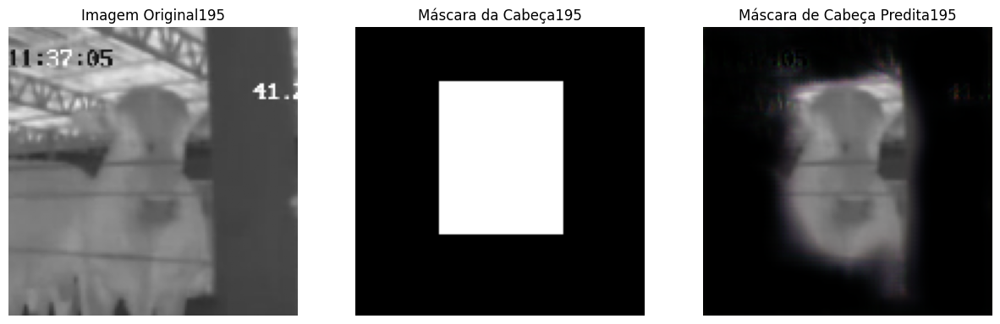

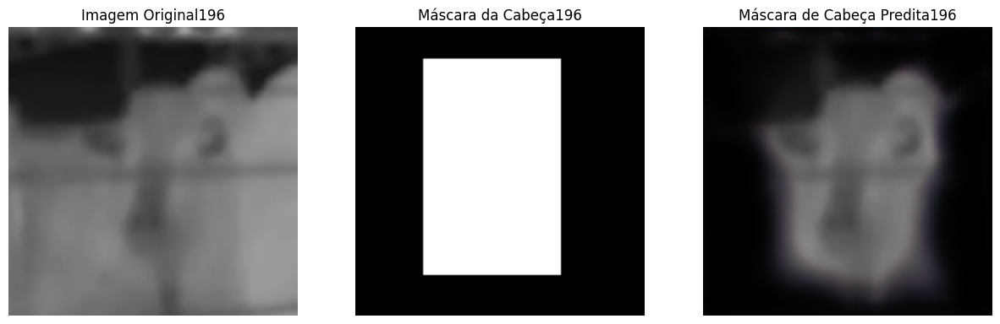

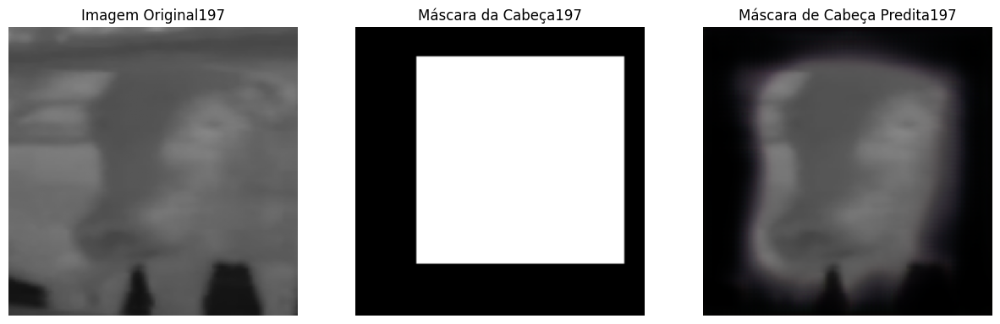

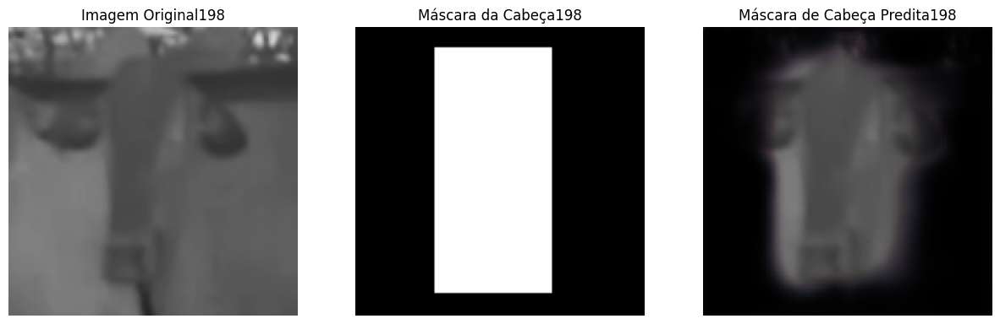

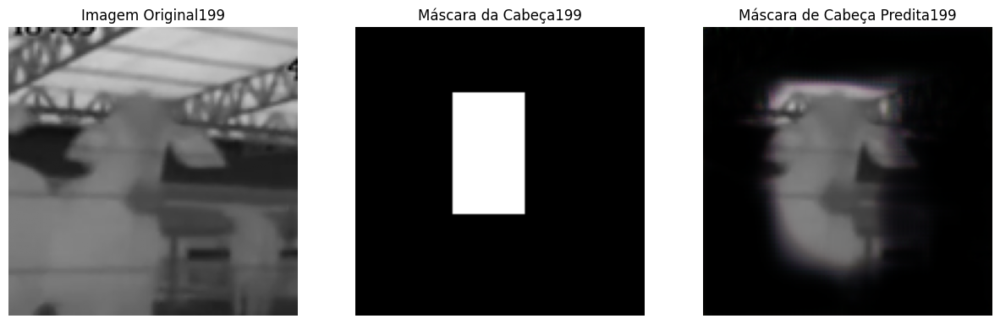

In [ ]:

for i in range(0, 200):
  # Configuração do layout para 1 linha e 3 colunas
  fig, axs = plt.subplots(1, 3, figsize=(15, 5))

  # Imagem original
  axs[0].imshow(X_test[i])
  axs[0].set_title(f"Imagem Original{i}")
  axs[0].axis('off')

  # Máscara da cabeça real
  axs[1].imshow(Y_head_test[i])
  axs[1].set_title(f"Máscara da Cabeça{i}")
  axs[1].axis('off')

  # Máscara de cabeça predita
  reshaped_tensor = prediction[i]
  axs[2].imshow(prediction[i]*X_test[i])
  axs[2].set_title(f"Máscara de Cabeça Predita{i}")
  axs[2].axis('off')

  # Exibindo as imagens
  plt.show()

### 6.1 Treinamento do Modelo **sem técnicas contra overfitting**

Ao treinar o modelo sem a utilização de técnicas contra overfitting, pode-se perceber claramente uma discrepância significativa entre a aplicação do modelo para dados de treino e de teste.

In [ ]:
checkpointer = ModelCheckpoint(
    filepath='/content/drive/MyDrive/CattleImageRepository/segmentacao.keras',
    verbose=1,
    save_best_only=True,
    mode="auto",
    monitor="loss"
)

In [ ]:
early_stopping = EarlyStopping(monitor='accuracy',
                               patience=7,
                               restore_best_weights=True)

In [ ]:
history = model_overfit.fit(
    X_train,
    Y_head_train,
    validation_split = 0.1,
    batch_size = 16,
    epochs = 30,
    callbacks=[])

Epoch 1/30
174/174 ━━━━━━━━━━━━━━━━━━━━ 68s 390ms/step - accuracy: 0.3112 - dice_coeff: 0.7814 - loss: 0.5466 - val_accuracy: 0.2709 - val_dice_coeff: 0.8053 - val_loss: 0.4617
Epoch 2/30
174/174 ━━━━━━━━━━━━━━━━━━━━ 61s 352ms/step - accuracy: 0.3257 - dice_coeff: 0.8213 - loss: 0.4457 - val_accuracy: 0.3255 - val_dice_coeff: 0.8330 - val_loss: 0.4256
Epoch 3/30
174/174 ━━━━━━━━━━━━━━━━━━━━ 66s 377ms/step - accuracy: 0.3285 - dice_coeff: 0.8432 - loss: 0.3970 - val_accuracy: 0.2525 - val_dice_coeff: 0.8449 - val_loss: 0.3935
Epoch 4/30
174/174 ━━━━━━━━━━━━━━━━━━━━ 63s 362ms/step - accuracy: 0.3184 - dice_coeff: 0.8588 - loss: 0.3590 - val_accuracy: 0.2920 - val_dice_coeff: 0.8518 - val_loss: 0.3951
Epoch 5/30
174/174 ━━━━━━━━━━━━━━━━━━━━ 60s 347ms/step - accuracy: 0.3087 - dice_coeff: 0.8688 - loss: 0.3356 - val_accuracy: 0.3350 - val_dice_coeff: 0.8596 - val_loss: 0.4093
Epoch 6/30
174/174 ━━━━━━━━━━━━━━━━━━━━ 64s 370ms/step - accuracy: 0.3120 - dice_coeff: 0.8843 - loss: 0.2965 - val

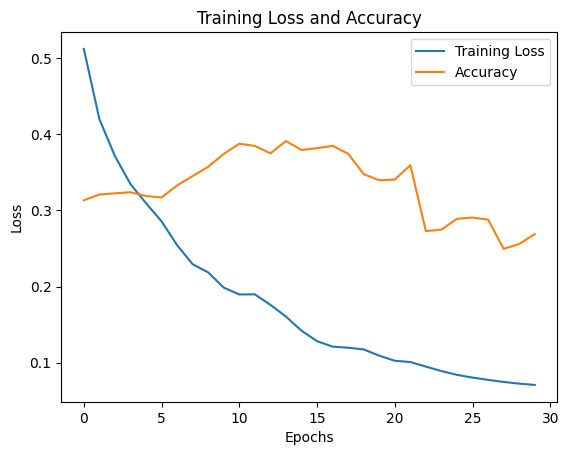

In [ ]:
# Dados
training_loss = history.history['loss']
accuracy = history.history['accuracy']

# Plot
plt.plot(training_loss, label='Training Loss')
plt.plot(accuracy, label='Accuracy')
plt.title('Training Loss and Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

O modelo performou melhor para os dados de treino quando comparado com o outro modelo que utiliza técnicas contra overfitting, contudo ao analisar os resultados para os dados de teste, percebe-se o overfitting.

In [ ]:
prediction = model.predict(X_test)

/usr/local/lib/python3.10/dist-packages/tensorflow/python/data/ops/structured_function.py:258: UserWarning: Even though the `tf.config.experimental_run_functions_eagerly` option is set, this option does not apply to tf.data functions. To force eager execution of tf.data functions, please use `tf.data.experimental.enable_debug_mode()`.
  warnings.warn(


25/25 ━━━━━━━━━━━━━━━━━━━━ 4s 157ms/step


*   Resultados: notamos que ao analisar os resultados obtivemos uma acurácia de 55%, que é consideravelmente inferior ao outro modelo(87%) para o mesmo conjunto de dados. Além disso, ao observar a segmentação das imagens dos dados de teste nota-se que o modelo não conseguiu segmentar de forma alguma a cabeça dos bovinos, demonstrando que está fortemente ajustado aos dados de treino.



In [ ]:

prediction_binary = (prediction > 0.5).astype(int)


y_true_flat = Y_head_test.flatten()
y_pred_flat = prediction_binary.flatten()


teste = classification_report(y_true_flat, y_pred_flat)
print(teste)

              precision    recall  f1-score   support

         0.0       0.60      0.78      0.68  23249258
         1.0       0.34      0.18      0.24  14696086

    accuracy                           0.55  37945344
   macro avg       0.47      0.48      0.46  37945344
weighted avg       0.50      0.55      0.51  37945344



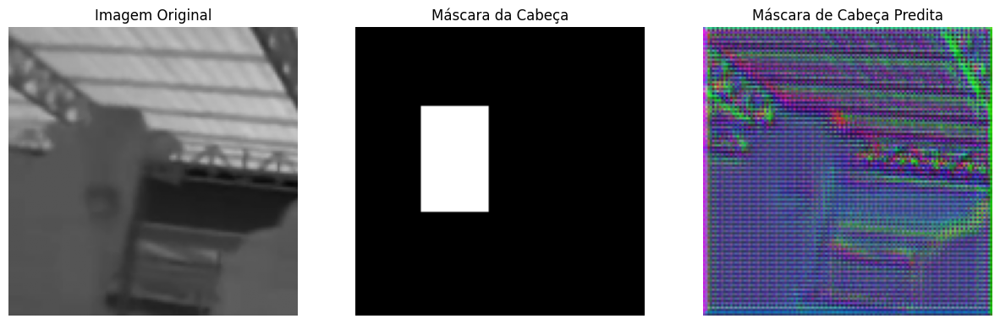

In [ ]:
# Configuração do layout para 1 linha e 3 colunas
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Imagem original
axs[0].imshow(X_test[55])
axs[0].set_title("Imagem Original")
axs[0].axis('off')

# Máscara da cabeça real
axs[1].imshow(Y_head_test[55])
axs[1].set_title("Máscara da Cabeça")
axs[1].axis('off')

# Máscara de cabeça predita
reshaped_tensor = prediction[55]
axs[2].imshow(reshaped_tensor)
axs[2].set_title("Máscara de Cabeça Predita")
axs[2].axis('off')

# Exibindo as imagens
plt.show()

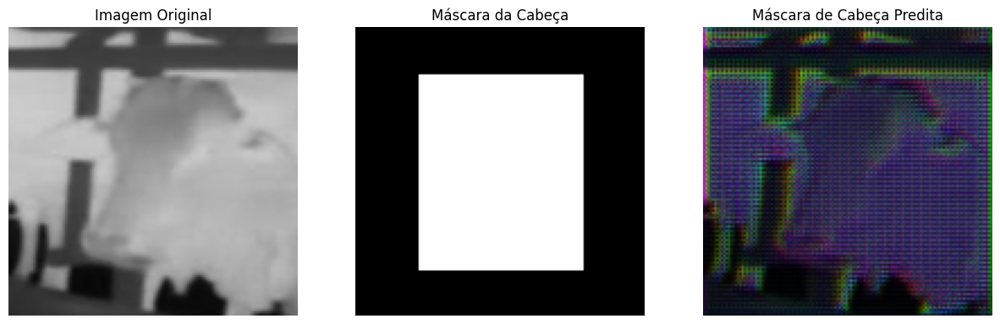

In [ ]:
# Configuração do layout para 1 linha e 3 colunas
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Imagem original
axs[0].imshow(X_test[100])
axs[0].set_title("Imagem Original")
axs[0].axis('off')

# Máscara da cabeça real
axs[1].imshow(Y_head_test[100])
axs[1].set_title("Máscara da Cabeça")
axs[1].axis('off')

# Máscara de cabeça predita
reshaped_tensor = prediction[100]
axs[2].imshow(prediction[100]*X_test[100])
axs[2].set_title("Máscara de Cabeça Predita")
axs[2].axis('off')

# Exibindo as imagens
plt.show()

# 7. Salvar modelo

In [ ]:
def transform_image(x, predictions):
  list_images = []
  for i in range(len(predictions)):
    list_images.append(x[i] * predictions[i])
  return list_images

In [ ]:
images = transform_image(X, prediction)

In [ ]:
def save_images_prediction(images_model, filename='predicao_cabeca.pkl'):
    with open(filename, 'wb') as file:
        pickle.dump(images_model, file)
    print(f"Dados salvos no arquivo {filename}")

In [ ]:
save_images_prediction(images, "/content/drive/MyDrive/CattleImageRepository/G2/predicao_cabeca_S3.pkl")

Dados salvos no arquivo /content/drive/MyDrive/CattleImageRepository/G2/predicao_cabeca.pkl


In [ ]:
imgs = load_images_model("/content/drive/MyDrive/CattleImageRepository/G2/predicao_cabeca_S3.pkl")

Dados carregados do arquivo /content/drive/MyDrive/CattleImageRepository/G2/predicao_cabeca.pkl


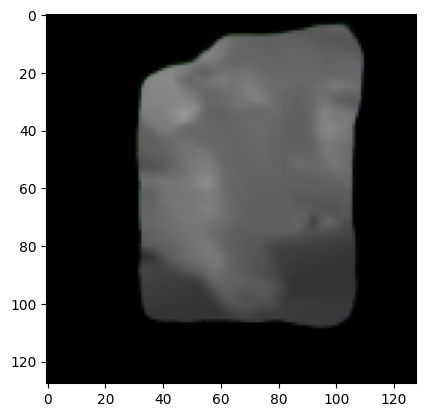

In [ ]:
plt.imshow(imgs[4])
plt.show()

# 8. Rodando com a CPU

In [ ]:
cpu_time_second, cpu_history_second = train_model_on_device("/CPU:0", model, X_train, Y_head_train, 0.1, [checkpointer, early_stopping], epochs = 45, batch_size = 16)

Epoch 1/41
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 11s/step - accuracy: 0.5141 - dice_coeff: 0.5811 - loss: 1.2256 
Epoch 1: loss improved from inf to 1.00264, saving model to /content/drive/MyDrive/CattleImageRepository/segmentacao.keras
87/87 ━━━━━━━━━━━━━━━━━━━━ 1023s 12s/step - accuracy: 0.5141 - dice_coeff: 0.5820 - loss: 1.2230 - val_accuracy: 0.8006 - val_dice_coeff: 0.7397 - val_loss: 1.1180
Epoch 2/41
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 11s/step - accuracy: 0.5340 - dice_coeff: 0.7617 - loss: 0.7288 
Epoch 2: loss improved from 1.00264 to 0.69660, saving model to /content/drive/MyDrive/CattleImageRepository/segmentacao.keras
87/87 ━━━━━━━━━━━━━━━━━━━━ 992s 11s/step - accuracy: 0.5340 - dice_coeff: 0.7618 - loss: 0.7284 - val_accuracy: 0.7566 - val_dice_coeff: 0.7847 - val_loss: 0.7440
Epoch 3/41
87/87 ━━━━━━━━━━━━━━━━━━━━ 0s 11s/step - accuracy: 0.5300 - dice_coeff: 0.7942 - loss: 0.6344 
Epoch 3: loss improved from 0.69660 to 0.61000, saving model to /content/drive/MyDrive/CattleImageReposit

# Comparação de Tempo de Treinamento entre CPU e GPU para Segmentação de Imagens

Nesta seção, comparamos o tempo de treinamento de um modelo de segmentação de imagens utilizando a CPU e a GPU. Abaixo estão os prints que mostram o tempo de execução de ambos os dispositivos:

- **Tempo de Treinamento na GPU:** 

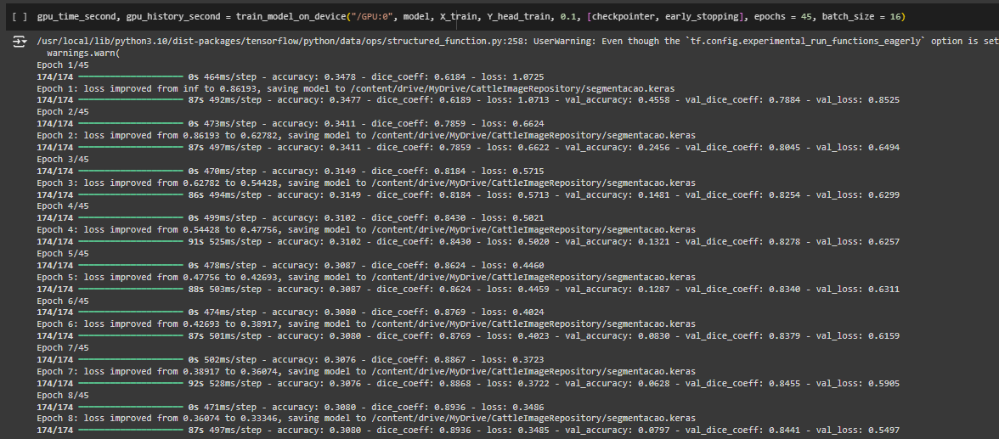

- **Tempo de Treinamento na CPU:**
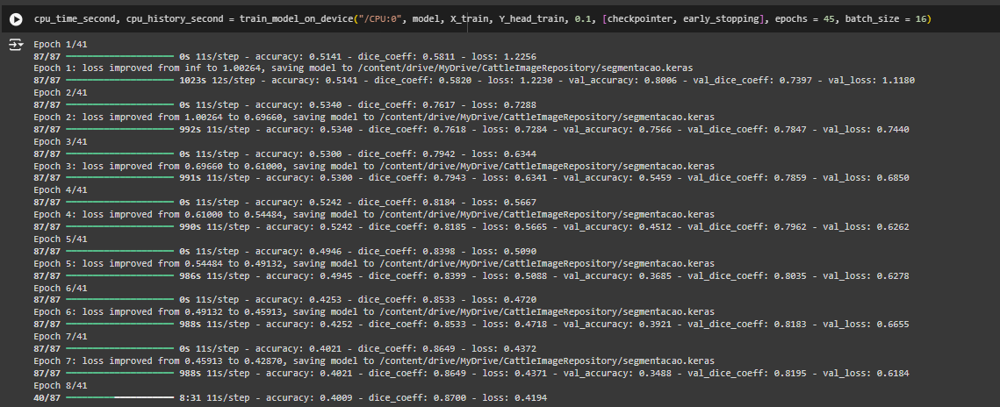

## Análise:

### 1. Tempo de Treinamento na GPU:
- O treinamento na GPU foi concluído em apoximadamente 12 minutos, demonstrando uma grande eficiência no processamento paralelo, crucial para tarefas como segmentação de imagens.
- O desempenho superior da GPU se deve à sua arquitetura, que é otimizada para lidar com operações massivamente paralelas, essenciais para o processamento de grandes conjuntos de imagens em tarefas de segmentação.

### 2. Tempo de Treinamento na CPU:
- O treinamento na CPU foi interrompido após aproximadamente 2 horas, sem que o processo fosse concluído. Isso indica a dificuldade da CPU em lidar com o processamento intensivo necessário para a segmentação de imagens, que envolve grandes volumes de dados e operações matemáticas complexas.
- A demora no treinamento torna a CPU uma escolha menos eficiente para esse tipo de tarefa, reforçando a importância de usar aceleradores como a GPU.

## Conclusão:

O treinamento do modelo de segmentação de imagens na CPU foi impraticável, levando mais de 2 horas sem ser finalizado. Em contrapartida, a GPU conseguiu completar o processo em um tempo significativamente menor. Para tarefas de segmentação, que envolvem grandes volumes de dados e cálculos intensivos, a GPU é claramente a escolha mais eficiente, oferecendo uma melhoria drástica no tempo de treinamento e na capacidade de iterar e ajustar o modelo mais rapidamente.
